In [15]:
import pandas as pd
import numpy as np
import pickle
from src.constants import *
from src.neuron import *
from src.utils import *
from src.network import *
from src.validation import *
from src.viz import *
from src.genetic_algorithm import *
from multiprocessing import Pool
from functools import partial
import ast

min_score = 729

In [2]:
# Load in unclean data
pkl_file = '/Users/stevenwendel/Documents/GitHub/bg/combined_data.pkl'

with open(pkl_file, 'rb') as f: 
    ga_results = pickle.load(f)


In [ ]:
print(run_experiment(ga_results[0]['dna']))

In [4]:
len(ga_results)

3803000

In [5]:
# Cut away any data that's less than threshold (728) and reduces all weights between -2 and 2
print(len(ga_results))
minimum_weight = 5
ga_results1 = []

for i in range(len(ga_results)):
    dna = ga_results[i]['dna'].copy()
    dna_score = ga_results[i]['dna_score']

    if dna_score >= min_score:
        for j in range(len(dna)):
            if abs(dna[j]) >= minimum_weight:
                ...
            else:
                dna[j] = 0 
        mod_dict = {
            'dna': tuple(dna), 
            'dna_score': dna_score, 
            'is_child': False}
        ga_results1.append(mod_dict)
print(len(ga_results1))

3803000
130048


In [6]:
# Remove duplicates from list of trial dictionaries
print(len(ga_results1))
ga_results2 = []
seen_configs = set()
for idx in range(len(ga_results1)):
    dna = tuple(ga_results1[idx]['dna'])
    if dna in seen_configs:
        continue
    else:
        seen_configs.add(dna)
        ga_results2.append(ga_results1[idx])
print(len(ga_results2))

130048
125419


In [7]:
# checking to make sure types are right
for idx in range(len(ga_results2)):
    if type(ga_results2[idx]['dna']) != tuple:
        print(type(ga_results2[idx]['dna']))
    # if type(ga_results[idx]['dna']) == list:
    #     print(idx)
    #     break

In [8]:
#Sort results
sorted_results = sorted(ga_results2, key=lambda x: x['dna_score'], reverse=True)
sorted_results[-1]

{'dna': (330,
  0,
  0,
  713,
  -127,
  0,
  0,
  0,
  -164,
  0,
  0,
  0,
  -55,
  -5,
  0,
  0,
  -269,
  0,
  -71,
  90,
  0,
  0,
  0,
  0,
  143,
  567,
  0,
  0,
  0,
  0,
  0,
  279,
  72,
  163,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -95,
  0,
  0,
  0,
  43,
  60,
  26),
 'dna_score': 729,
 'is_child': False}

In [9]:
max_synapses = 25
max_length_dnas = []

print(len(sorted_results))

for i in range(len(sorted_results)):
    trial_dna = sorted_results[i]['dna']
    config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
    synapses = sum(config_mask)
    if synapses <= max_synapses:
        max_length_dnas.append(sorted_results[i])
        
print(len(max_length_dnas))

125419
125418


In [16]:
from multiprocessing import get_context

def _process_trial(args):
    idx, dna, orig_score = args
    # Execute the expensive run_experiment call in a worker process
    new_score = run_experiment(dna, [0, 0, 0, 0])
    print(f"Processing {idx}/{len(max_length_dnas)} ~~~ Original Score: {orig_score} ~~~ New Score: {new_score}")
    # Return the index so we can place the result back into max_length_dnas
    return idx, orig_score, new_score

# Build a list of arguments for each trial: (index, dna tuple, original score)
trial_args = [
    (i, trial['dna'], trial['dna_score'])
    for i, trial in enumerate(max_length_dnas)
]

# Use a fork-based context so child processes inherit this function definition
ctx = get_context('fork')
with ctx.Pool() as pool:
    results = pool.map(_process_trial, trial_args)

# Update the original list with the new scores and print progress
for idx, original_score, new_score in results:
    max_length_dnas[idx]['dna_score'] = new_score

    === DNA: (602, 0, 0, 1000, -26, -7, 0, 0, -35, 0, 0, 0, -80, 0, 0, 0, -1000, 0, 0, 58, 0, 0, 0, 0, 1000, 233, 0, 0, 0, 0, 0, 43, 84, 569, 0, 0, 0, 0, 0, 0, 0, 0, -1000, -130, 0, 0, 42, 499, 246)
    === Control: 249/500
    === Experimental: 492/500    === DNA: (86, 0, 0, 1000, -22, -161, 0, 0, -56, 0, 0, 0, -59, 0, 0, 0, -487, 0, 0, 191, 0, 0, 0, 0, 547, 566, -16, 0, 0, 0, 0, 252, 48, 92, 0, 0, 0, 0, 0, 0, 0, 0, -881, 0, 0, 0, 20, 218, 139)
    === Overall: 741(74.10%)

    === Control: 249/500    === DNA: (427, 0, 0, 541, -24, 0, 0, 0, -194, 0, 0, 0, -6, 0, 0, 0, -1000, 0, 0, 35, 0, 0, 0, 0, 791, 646, 0, 0, 0, 0, 0, 193, 240, 103, 0, 0, 0, 0, 0, 0, 0, 0, -527, 0, 0, 0, 34, 229, 179)

    === DNA: (579, 0, 0, 758, -10, -17, 0, 0, -35, 0, 0, 0, -52, 0, 0, 0, -1000, 0, 0, 53, 0, 0, 0, 0, 1000, 167, 0, 0, 0, 0, 0, 209, 200, 185, 0, 0, 0, 0, 0, 0, 0, 0, -698, 0, 0, 0, 22, 225, 120)    === Experimental: 487/500


    === Control: 248/500Processing 0/125418 ~~~ Original Score: 741 ~~~ N

KeyboardInterrupt: 

In [30]:
unique_dna_sequences = set()
unique_trials = []

for i in range(len(max_length_dnas)):
    trial_dna = max_length_dnas[i]['dna']
    config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
    if config_mask in unique_dna_sequences:
        print(f'seen this before...{config_mask}')
        continue
    else:
        print(f'A new mask! {config_mask}')
        unique_dna_sequences.add(config_mask)
        unique_trials.append(max_length_dnas[i])

A new mask! (1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 

In [31]:
print(len(unique_dna_sequences))
print(len(unique_trials))

1348
1348


In [16]:
#saving the cleaned data
with open(f'combined_data_clean_{min_score}_pass_0.pkl', 'wb') as f:
    pickle.dump(unique_trials, f)

In [17]:
#loading the cleaned data
with open(f'/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_{min_score}_pass_0.pkl', 'rb') as f:
    clean_unique_runs = pickle.load(f)    

In [13]:
clean_unique_runs

[{'dna': (602,
   0,
   0,
   1000,
   -26,
   -7,
   0,
   0,
   -35,
   0,
   0,
   0,
   -80,
   0,
   0,
   0,
   -1000,
   0,
   0,
   58,
   0,
   0,
   0,
   0,
   1000,
   233,
   0,
   0,
   0,
   0,
   0,
   43,
   84,
   569,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   -1000,
   -130,
   0,
   0,
   42,
   499,
   246),
  'dna_score': 741,
  'is_child': False},
 {'dna': (1000,
   0,
   0,
   888,
   -32,
   -8,
   0,
   0,
   -27,
   0,
   0,
   0,
   -36,
   0,
   0,
   0,
   -708,
   0,
   0,
   46,
   0,
   0,
   0,
   0,
   950,
   397,
   0,
   0,
   0,
   0,
   0,
   411,
   101,
   525,
   0,
   0,
   0,
   0,
   -16,
   0,
   0,
   0,
   -180,
   -105,
   0,
   0,
   42,
   632,
   229),
  'dna_score': 741,
  'is_child': False},
 {'dna': (1000,
   0,
   0,
   1000,
   -7,
   0,
   0,
   0,
   -17,
   0,
   0,
   0,
   -26,
   0,
   0,
   0,
   -1000,
   0,
   -15,
   63,
   0,
   0,
   0,
   0,
   445,
   180,
   -173,
   0,
   0,
   0,
   0,
   28,
   169,
  

In [ ]:

from src.workers import process_parent_dna
from multiprocessing import Manager, Process, Pool
import time
# PREVIOUSLY CLEAN_UNIQUE_RUNS
parents = max_length_dnas
fully_reduced_dnas = []
min_score

iteration=0
start_time= time.time()
unique_dna_sequences = set()

while len(parents)>0:
    current_time = time.time()
    print(f'Beginning iteration #{iteration}')
    print(f'Current # of fully_reduced_dnas: {len(fully_reduced_dnas)}')
    print(f'Current # of young parents: {len(parents)}')
    unique_dna_sequences = set()




    with Pool(processes=6) as pool:
        ffunct =  partial(process_parent_dna, min_score=min_score, unique_dna_sequences=unique_dna_sequences)
        results = pool.map(ffunct, parents)
    # print(results)

    children = []
    for processor in results:
        if processor:
            print("inspecting processor...")
            for survivor in processor:
                if survivor:
                    print('inspecting survivor...')
                    trial_dna = survivor['dna']
                    config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
                    if config_mask not in unique_dna_sequences:
                        if survivor['is_child']:
                            children.append(survivor)
                        elif not survivor['is_child']:
                                print(f'A new mask! {config_mask}')
                                unique_dna_sequences.add(config_mask)
                                fully_reduced_dnas.append(survivor)

    print(f'# Children produced in pass: {len(children)}')
    print(f'Pass took: {time.time()-current_time} seconds')
    iteration +=1

    
    #saving the cleaned data
    with open(f'combined_data_clean_{min_score}_pass_{iteration}.pkl', 'wb') as f:
        pickle.dump({'fully_reduced_dnas': fully_reduced_dnas, 'children': children}, f)

    parents = children

print(f'All runs took {time.time()-start_time} seconds')

Beginning iteration #0
Current # of fully_reduced_dnas: 0
Current # of young parents: 2001
Process 63110 working...
Process 63108 working...
Process 63106 working...
Process 63109 working...
Process 63107 working...
Process 63105 working...
faulty parent ~~ original score: 738 ~~ real score: 719
Process 63109 working...
 Found child #0! == Gene: 5 == Child Score: 741 == Delta: 0
 Found child #0! == Gene: 5 == Child Score: 738 == Delta: 0
 Found child #0! == Gene: 5 == Child Score: 738 == Delta: -1
 Found child #1! == Gene: 27 == Child Score: 738 == Delta: 0
 Found child #1! == Gene: 35 == Child Score: 739 == Delta: 0
Parent added to fully_reduced: No valid children found
Process 63107 working...
Parent added to fully_reduced: No valid children found
Process 63108 working...
faulty parent ~~ original score: 739 ~~ real score: 735
Process 63107 working...
Process 63106 working...
Process 63110 working...
Process 63105 working...
faulty parent ~~ original score: 738 ~~ real score: 737
Pro

TypeError: process_parent_dna() missing 1 required positional argument: 'unique_dna_sequences'

In [44]:
print(len(children))
print(len(fully_reduced_dnas))

0
19


In [45]:
pass_selection = iteration -1
with open(f'/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_{min_score}_pass_{iteration}.pkl', 'rb') as f:
    pass_results = pickle.load(f)

In [46]:

print(len(clean_unique_runs))
print(len(pass_results['fully_reduced_dnas']))
print(len(pass_results['children']))

49
19
0


In [38]:
i=0
print(pass_results['children'][i]['dna'])
print(pass_results['children'][i]['dna_score'])


IndexError: list index out of range

This is for checking stuff later


In [ ]:
 #CHECK RESULTS
curr_dna = pass_results['fully_reduced_dnas'][0]['dna']
# Load DNA
dna_matrix = load_dna(curr_dna)


# === Preparing Network === 
all_neurons = create_neurons()
splits, input_waves, alpha_array = create_experiment()
criteria_dict = define_criteria()
max_score = TMAX//BIN_SIZE * len(CRITERIA_NAMES)

dna_score, neuron_data = evaluate_dna(
                dna_matrix=dna_matrix,
                neurons=all_neurons,
                alpha_array=alpha_array,
                input_waves=input_waves,
                criteria=criteria_dict
                )
total_score = sum(dna_score.values())
print(f'    === DNA: {curr_dna}') 
print(f'    === Control: {dna_score["control"]}/{max_score}')
print(f'    === Experimental: {dna_score["experimental"]}/{max_score}')
print(f'    === Overall: {total_score}({total_score/(2*max_score):.2%})')
print('\n')


diagnostic = {
        'show_dna_matrix' : True,
        'show_neuron_plots' : True,
        'show_difference_histogram' : False,
        'show_dna_scores': False
    }

if diagnostic['show_dna_matrix']:
                print("Currently loaded matrix ---")
                display_matrix(dna_matrix, NEURON_NAMES)

if diagnostic['show_dna_scores']:
                print(f'{dna_score=}: {curr_dna}')
            
if diagnostic['show_neuron_plots']:
                for condition in ['experimental', 'control']:
                    target_neurons_hist_Vs = np.array([neuron_data[condition][name]['hist_V'] for name in NEURON_NAMES])
                    plot_neurons_interactive(hist_Vs=target_neurons_hist_Vs, neuron_names=NEURON_NAMES, sq_wave=input_waves[0], go_wave=input_waves[1], show_u=False)
                    

And below here we have the graph...

In [48]:
# Calculate proportion of graphs with vector
# Calculate the number of DNAs

num_dnas = len(pass_results['fully_reduced_dnas'])

# Determine which connections are shared by more than 50% of the DNAs
shared_connections = np.zeros(len(ACTIVE_SYNAPSES), dtype=int)

for item in pass_results['fully_reduced_dnas']:
    shared_connections += np.array([1 if weight != 0 else 0 for weight in item['dna']])
    
connection_percentages = np.round(shared_connections/num_dnas*100,0)

cpl = [int(i) if i>=50 else 0 for i in connection_percentages]
print(cpl)

[100, 0, 0, 100, 100, 0, 0, 0, 100, 0, 0, 0, 100, 0, 0, 0, 100, 0, 0, 100, 0, 0, 0, 0, 100, 100, 0, 0, 0, 0, 0, 100, 100, 100, 0, 0, 0, 0, 0, 0, 0, 0, 68, 0, 0, 0, 100, 100, 100]


In [41]:
print(len(cpl))
print(len(ACTIVE_SYNAPSES))

49
49


In [42]:
# Create a labeled Series for the DNA for reference - don't need for graph
cplSeries = pd.Series(cpl, index=[f"{pair[0]} -> {pair[1]}" for pair in ACTIVE_SYNAPSES])
print(cplSeries)


Somat -> ALMprep       100
Somat -> ALMinter        0
Somat -> ALMresp         0
Somat -> MSN1          100
MSN1 -> SNR1           100
MSN1 -> SNR2             0
MSN1 -> SNR3             0
MSN2 -> SNR1             0
MSN2 -> SNR2           100
MSN2 -> SNR3             0
MSN3 -> SNR1             0
MSN3 -> SNR2             0
MSN3 -> SNR3           100
SNR1 -> VMprep           0
SNR1 -> VMresp           0
SNR2 -> VMprep           0
SNR2 -> VMresp         100
SNR3 -> VMprep           0
SNR3 -> VMresp           0
VMprep -> ALMprep      100
VMprep -> ALMinter       0
VMprep -> ALMresp        0
VMresp -> ALMprep        0
VMresp -> ALMinter       0
VMresp -> ALMresp      100
ALMprep -> MSN2        100
ALMinter -> MSN1         0
ALMinter -> MSN2         0
ALMinter -> MSN3         0
ALMresp -> MSN1          0
ALMresp -> MSN2          0
ALMresp -> MSN3        100
ALMprep -> VMprep      100
ALMresp -> VMresp      100
MSN1 -> MSN2             0
MSN1 -> MSN3             0
MSN2 -> MSN1             0
M

Somat --4.0--> MSN1. Original val: 95
MSN1 --3.0--> SNR1. Original val: 85
MSN2 --3.0--> SNR2. Original val: 67
MSN3 --2.0--> SNR3. Original val: 57
ALMinter --4.0--> ALMprep. Original val: 94
ALMprep --4.0--> MSN2. Original val: 95
ALMprep --4.0--> SNR2. Original val: 100
ALMprep --4.0--> Somat. Original val: 100
THALgo --4.0--> ALMinter. Original val: 95
THALgo --4.0--> ALMresp. Original val: 100
PPN --4.0--> THALgo. Original val: 100
ALMresp --3.0--> MSN3. Original val: 90
ALMresp --4.0--> VMresp. Original val: 100
VMresp --4.0--> PPN. Original val: 98
ALMprep --3.0--> VMprep. Original val: 74
VMprep --3.0--> ALMprep. Original val: 70
VMresp --3.0--> ALMresp. Original val: 80


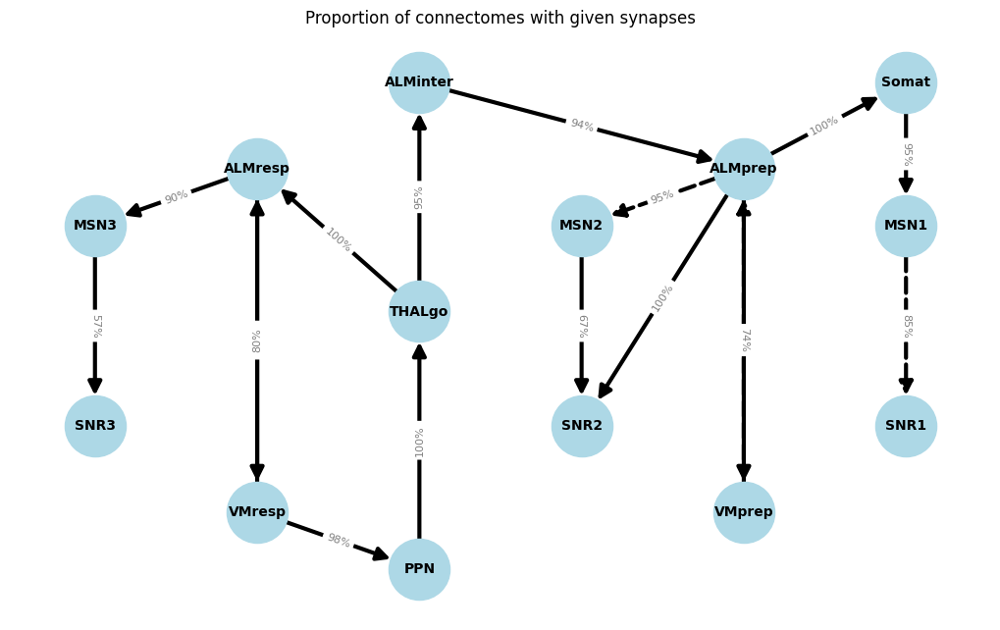

In [55]:
import networkx as nx
import matplotlib.pyplot as plt

# Define custom positions for each node
neu_coords = {
    'Somat': (5, 8.5),
    'MSN1': (5, 6),
    'MSN2': (3, 6),
    'MSN3': (0, 6),
    'SNR1': (5, 2.5),
    'SNR2': (3, 2.5),
    'SNR3': (0, 2.5),
    'ALMinter': (2, 8.5),
    'PPN': (2, 0),
    'THALgo': (2, 4.5),
    'VMprep': (4, 1),
    'ALMprep': (4, 7),
    'ALMresp': (1, 7),
    'VMresp': (1, 1)
}

# Create a graph
G = nx.DiGraph()

# Add nodes for each neuron
G.add_nodes_from(NEURON_NAMES)

# Add edges, styles, and widths for non-zero synaptic connections
edge_widths =[]
edge_styles = []
for i in range(len(cpl)):
    val = cpl[i]
    if val != 0:
        print(f'{ACTIVE_SYNAPSES[i][0]} --{np.ceil(val / 30)}--> {ACTIVE_SYNAPSES[i][1]}. Original val: {val}')
        
        G.add_edge(ACTIVE_SYNAPSES[i][0], ACTIVE_SYNAPSES[i][1], weight=f'{val}%')

        # edge_widths.append(val//20 -1) 
        edge_widths.append(3)
        
        if ACTIVE_SYNAPSES[i][0] in INHIBITORY_NEURONS:
            edge_styles.append('dashed')
        else:
            edge_styles.append('solid')


# Draw the main graph using the custom positions
plt.figure(figsize=(10, 6))
edges = G.edges(data=True)
nx.draw(G, pos=neu_coords,
        with_labels=True, 
        node_size=2000, 
        node_color='lightblue', 
        font_size=10, 
        font_weight='bold', 
        arrowsize=20,
        width=edge_widths,
        style=edge_styles,
        edge_color='black')


# Add edge labels
edge_labels = nx.get_edge_attributes(G, 'weight')
nx.draw_networkx_edge_labels(G, pos=neu_coords, edge_labels=edge_labels, font_color='gray',font_size=8)

plt.title('Proportion of connectomes with given synapses')
plt.show()

Adding edges:
Somat --(100%, solid)--> ALMprep
Somat --(95%, solid)--> MSN1
MSN1 --(85%, dashed)--> SNR1
MSN1 --(58%, dashed)--> SNR2
MSN2 --(65%, dashed)--> SNR2
MSN3 --(57%, dashed)--> SNR3
SNR2 --(98%, dashed)--> VMresp
VMprep --(100%, solid)--> ALMprep
VMresp --(100%, solid)--> ALMresp
ALMprep --(95%, solid)--> MSN2
ALMresp --(90%, solid)--> MSN3
ALMprep --(100%, solid)--> VMprep
ALMresp --(100%, solid)--> VMresp
ALMinter --(94%, dashed)--> ALMprep
PPN --(100%, solid)--> THALgo
THALgo --(98%, solid)--> ALMinter
THALgo --(100%, solid)--> ALMresp
Drawing 13 non-reciprocal edges...
Drawing 4 reciprocal edges...
Drawing edge labels (inline)...


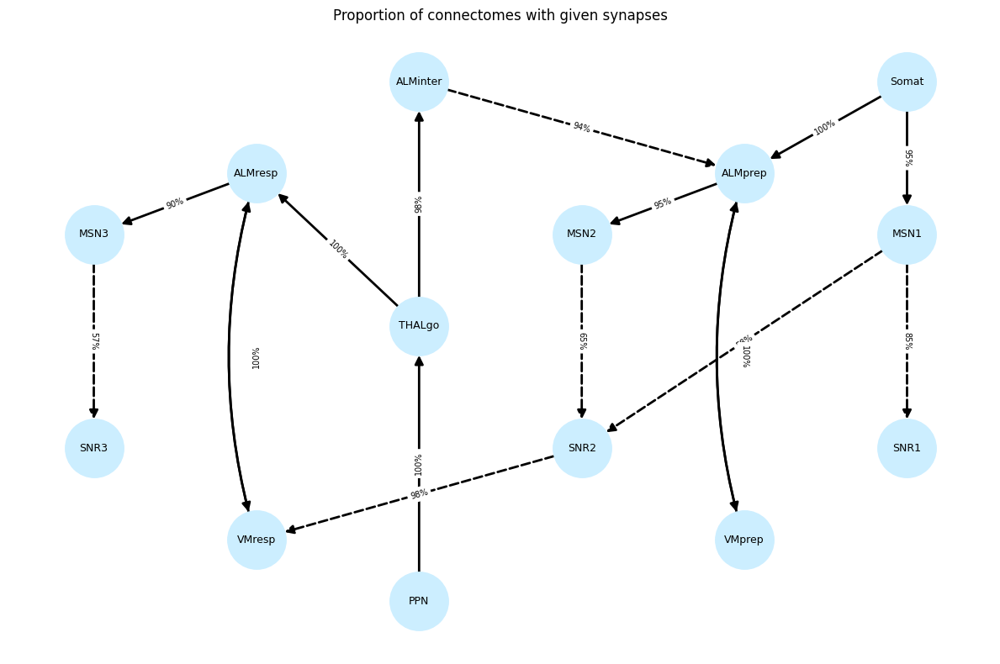

In [ ]:
# Version 2
# Create a graph
G = nx.DiGraph()

# Add nodes for each neuron
G.add_nodes_from(NEURON_NAMES)

# Add edges with attributes (weight, style, width) for non-zero connections
print("Adding edges to graph:")
# Ensure lengths match if using separate lists originally
if len(cpl) != len(ACTIVE_SYNAPSES):
     raise ValueError("Length mismatch between cpl and ACTIVE_SYNAPSES")

for i in range(len(cpl)):
    val = cpl[i]
    u, v = ACTIVE_SYNAPSES[i]

    # Basic check for validity
    if u not in NEURON_NAMES or v not in NEURON_NAMES:
        print(f"Warning: Skipping edge {u}->{v}. Node not defined in NEURON_NAMES.")
        continue

    if val != 0:
        # Determine style based on source neuron
        style = 'dashed' if u in INHIBITORY_NEURONS else 'solid'
        # Define width (e.g., constant or based on val)
        width = 2 # Example fixed width, adjust as needed
        weight_label = f'{val}%'

        # Add edge with all relevant data as attributes
        G.add_edge(u, v, weight=weight_label, style=style, width=width)
        # Optional print statement from original code:
        # print(f'{u} --{np.ceil(val / 30)}--> {v}. Original val: {val}')

# --- Drawing Logic (Replaces the single nx.draw call) ---
plt.figure(figsize=(12, 8)) # Adjusted figure size
ax = plt.gca() # Get axes for drawing

# 1. Draw nodes and node labels
print("\nDrawing nodes and labels...")
nx.draw_networkx_nodes(G, pos=neu_coords, node_size=2000, node_color='lightblue', ax=ax)
nx.draw_networkx_labels(G, pos=neu_coords, font_size=10, font_weight='bold', ax=ax)

# 2. Separate edges into reciprocal and non-reciprocal
print("\nSeparating edge types...")
reciprocal_edges_pairs = set()
non_reciprocal_edges_data = [] # Store tuples (u, v, data)
all_edges_with_data = list(G.edges(data=True))

for u, v, data in all_edges_with_data:
    if G.has_edge(v, u):
        pair = tuple(sorted((u, v)))
        reciprocal_edges_pairs.add(pair) # Store unique pairs
    else:
        non_reciprocal_edges_data.append((u, v, data))
print(f"  Found {len(non_reciprocal_edges_data)} non-reciprocal edges.")
print(f"  Found {len(reciprocal_edges_pairs)} reciprocal pairs.")


# --- 3. Draw Edges ---

# 3a. Draw non-reciprocal edges (using NetworkX draw_networkx_edges)
if non_reciprocal_edges_data:
    print(f"\nDrawing non-reciprocal edges...")
    edgelist_nr = [(u, v) for u, v, data in non_reciprocal_edges_data]
    # Retrieve styles and widths *from edge attributes*
    styles_nr = [data['style'] for u, v, data in non_reciprocal_edges_data]
    widths_nr = [data['width'] for u, v, data in non_reciprocal_edges_data]
    nx.draw_networkx_edges(G, pos=neu_coords, edgelist=edgelist_nr,
                           node_size=2000, # Match node size
                           arrowstyle='-|>', arrowsize=20, # User's original arrowsize
                           edge_color='black',
                           width=widths_nr, # Use specific widths
                           style=styles_nr, # Use specific styles
                           connectionstyle='arc3,rad=0', ax=ax) # Straight line

# 3b. Draw reciprocal edges MANUALLY as offset parallel lines
if reciprocal_edges_pairs:
    print(f"\nDrawing reciprocal edges (manual parallel)...")
    # --- Parameters to TUNE for parallel lines ---
    parallel_offset = 0.12  # Increased offset slightly
    shorten_length = 0.35 # Increased shortening slightly (adjust based on node_size=2000)

    for u_orig, v_orig in reciprocal_edges_pairs:
        pos_u = np.array(neu_coords[u_orig])
        pos_v = np.array(neu_coords[v_orig])

        vec = pos_v - pos_u
        vec_len = np.linalg.norm(vec)
        if vec_len < 1e-6: continue
        unit_vec = vec / vec_len
        perp_vec = np.array([-unit_vec[1], unit_vec[0]])

        start_node_adj = unit_vec * shorten_length
        end_node_adj = unit_vec * shorten_length

        # Arrow 1: u -> v (offset by +perp_vec)
        start1 = pos_u + start_node_adj + perp_vec * parallel_offset
        end1   = pos_v - end_node_adj   + perp_vec * parallel_offset
        edge_data_uv = G.get_edge_data(u_orig, v_orig)
        style_uv = edge_data_uv.get('style', 'solid')
        width_uv = edge_data_uv.get('width', 2) # Use default width if not found
        ls_uv = '--' if style_uv == 'dashed' else '-'
        ax.annotate("", xy=end1, xycoords='data', xytext=start1, textcoords='data',
                    arrowprops=dict(arrowstyle='-|>', color='black',
                                    linestyle=ls_uv, linewidth=width_uv))

        # Arrow 2: v -> u (offset by -perp_vec)
        start2 = pos_v - start_node_adj - perp_vec * parallel_offset
        end2   = pos_u + end_node_adj   - perp_vec * parallel_offset
        edge_data_vu = G.get_edge_data(v_orig, u_orig)
        style_vu = edge_data_vu.get('style', 'solid')
        width_vu = edge_data_vu.get('width', 2)
        ls_vu = '--' if style_vu == 'dashed' else '-'
        ax.annotate("", xy=end2, xycoords='data', xytext=start2, textcoords='data',
                    arrowprops=dict(arrowstyle='-|>', color='black',
                                    linestyle=ls_vu, linewidth=width_vu))

# --- 4. Draw Labels ---
print("\nDrawing edge labels...")
all_edge_labels = nx.get_edge_attributes(G, 'weight')

# 4a. Draw labels for non-reciprocal edges
labels_nr = {}
for u, v, data in non_reciprocal_edges_data:
    edge_tuple = (u, v)
    if edge_tuple in all_edge_labels:
         labels_nr[edge_tuple] = all_edge_labels[edge_tuple]
if labels_nr:
     print(f"  Drawing {len(labels_nr)} non-reciprocal labels...")
     nx.draw_networkx_edge_labels(G, pos=neu_coords, edge_labels=labels_nr,
                                 label_pos=0.5, rotate=True, # Use networkx rotation
                                 font_color='gray', font_size=8, # User's original font
                                 bbox=None, # No background box
                                 ax=ax)

# 4b. Draw labels for reciprocal edges MANUALLY
if reciprocal_edges_pairs:
    print(f"\n  Drawing {len(reciprocal_edges_pairs)*2} reciprocal labels (manual)...")
    # --- Parameters for TUNE for label placement ---
    label_pos_factor = 0.6 # Position along the line (0.5=mid)
    label_perp_offset = parallel_offset * 1.3 # Perpendicular offset

    for u_orig, v_orig in reciprocal_edges_pairs:
        pos_u = np.array(neu_coords[u_orig])
        pos_v = np.array(neu_coords[v_orig])
        vec = pos_v - pos_u
        vec_len = np.linalg.norm(vec)
        if vec_len < 1e-6: continue
        unit_vec = vec / vec_len
        perp_vec = np.array([-unit_vec[1], unit_vec[0]])

        angle_rad = np.arctan2(vec[1], vec[0])
        angle_deg = np.degrees(angle_rad)
        if 90 < angle_deg <= 180: angle_deg -= 180
        if -180 < angle_deg <= -90: angle_deg += 180

        common_text_args = dict(ha='center', va='center', rotation=angle_deg,
                                rotation_mode='anchor',
                                color='gray', size=8) # Match user's font style

        # Label 1: u -> v
        label_uv_val = all_edge_labels.get((u_orig, v_orig))
        if label_uv_val:
             label_pos1 = pos_u + unit_vec * vec_len * label_pos_factor + perp_vec * label_perp_offset
             ax.text(label_pos1[0], label_pos1[1], label_uv_val, **common_text_args)

        # Label 2: v -> u
        label_vu_val = all_edge_labels.get((v_orig, u_orig))
        if label_vu_val:
             label_pos2 = pos_v - unit_vec * vec_len * label_pos_factor - perp_vec * label_perp_offset
             ax.text(label_pos2[0], label_pos2[1], label_vu_val, **common_text_args)


# --- Final Plotting ---
plt.title('Proportion of connectomes with given synapses')
plt.axis('off') # Hide axes
plt.tight_layout() # Adjust layout
plt.margins(0.1) # Add margins
plt.show()

In [ ]:
#

Adjusting potentially duplicate reciprocal definitions...
Adding edges:
  Adding: Somat --(95%, solid)--> MSN1
  Adding: MSN1 --(85%, dashed)--> SNR1
  Adding: MSN2 --(67%, dashed)--> SNR2
  Adding: MSN3 --(57%, dashed)--> SNR3
  Adding: ALMinter --(94%, solid)--> ALMprep
  Adding: ALMprep --(95%, solid)--> MSN2
  Adding: ALMprep --(100%, solid)--> SNR2
  Adding: ALMprep --(100%, solid)--> Somat
  Adding: THALgo --(95%, solid)--> ALMinter
  Adding: THALgo --(100%, solid)--> ALMresp
  Adding: PPN --(100%, solid)--> THALgo
  Adding: ALMresp --(90%, solid)--> MSN3
  Adding: ALMresp --(100%, solid)--> VMresp
  Adding: VMresp --(98%, solid)--> PPN
  Adding: ALMprep --(74%, solid)--> VMprep
  Adding: VMprep --(70%, solid)--> ALMprep
  Adding: VMresp --(80%, solid)--> ALMresp
Adding edges:

Separating edge types:
  Found reciprocal pair: ('ALMprep', 'VMprep')
  Found reciprocal pair: ('ALMresp', 'VMresp')

Drawing 13 non-reciprocal edges...

Drawing 4 reciprocal edges (manual parallel)...
  D

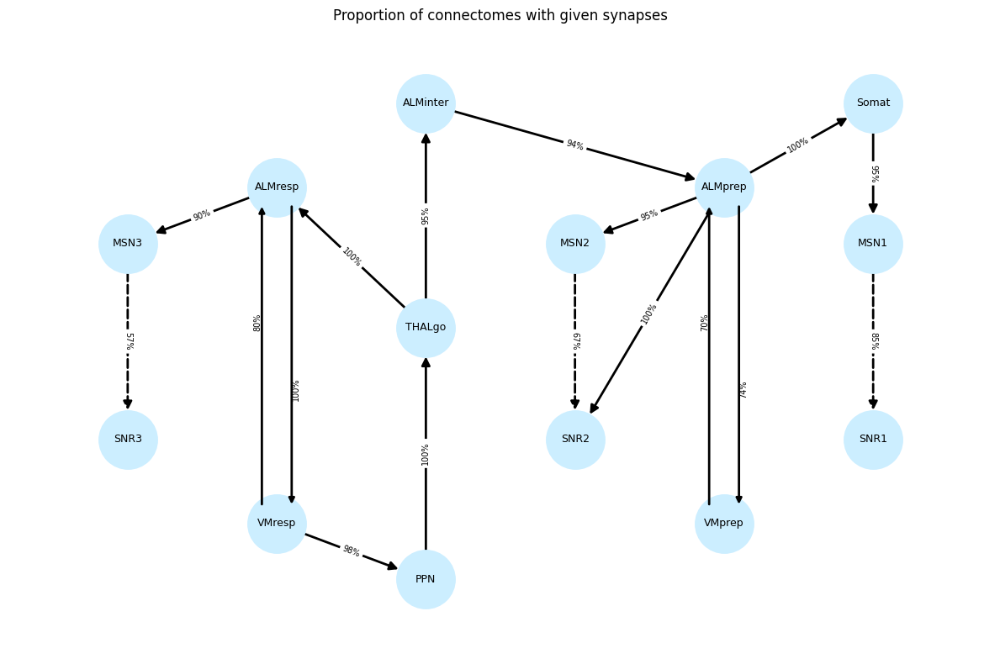

In [54]:
# version 3
cpl_values = {
    ('Somat', 'MSN1'): 95, ('MSN1', 'SNR1'): 85, ('MSN2', 'SNR2'): 67,
    ('MSN3', 'SNR3'): 57, ('ALMinter', 'ALMprep'): 94, ('ALMprep', 'MSN2'): 95,
    ('ALMprep', 'SNR2'): 100, ('ALMprep', 'Somat'): 100, ('THALgo', 'ALMinter'): 95,
    ('THALgo', 'ALMresp'): 100, ('PPN', 'THALgo'): 100, ('ALMresp', 'MSN3'): 90,
    ('ALMresp', 'VMresp'): 100, ('VMresp', 'PPN'): 98, # Assuming 98% from image
    # --- RECIPROCAL PAIRS ---
    ('ALMprep', 'VMprep'): 74, # Example value, check your real data
    ('VMprep', 'ALMprep'): 70, # Example value, check your real data
    ('VMresp', 'ALMresp'): 80, # Example value, check your real data
    # Note: ('ALMresp', 'VMresp') = 100% is already defined above.
    # The LAST definition in the dict for a key wins. Ensure you have the correct % for each direction.
    # Let's assume ALMresp -> VMresp is 100%, and VMresp -> ALMresp is 80%
}
# Correct the potential duplicate key issue
if ('ALMresp', 'VMresp') in cpl_values and ('VMresp', 'ALMresp') in cpl_values:
     print("Adjusting potentially duplicate reciprocal definitions...")
     # Keep the explicitly defined values if they exist
     # Example: Keep ALMresp->VMresp = 100, VMresp->ALMresp = 80
     # No code change needed if the dict is built correctly like above.

ACTIVE_SYNAPSES = list(cpl_values.keys())
cpl = list(cpl_values.values())
INHIBITORY_NEURONS = {'MSN1', 'MSN2', 'MSN3', 'SNR1', 'SNR2', 'SNR3'} # Assuming SNRs are inhibitory targets/sources based on dashes

# Create graph and add nodes
G = nx.DiGraph()
G.add_nodes_from(NEURON_NAMES)

# Add edges with attributes
print("Adding edges:")
for i in range(len(cpl)):
    val = cpl[i]
    if val != 0 and i < len(ACTIVE_SYNAPSES):
        u, v = ACTIVE_SYNAPSES[i]
        if u in NEURON_NAMES and v in NEURON_NAMES:
            # Determine style (Example: based on source neuron)
            style = 'dashed' if u in INHIBITORY_NEURONS else 'solid'
             # Or check target: style = 'dashed' if v in INHIBITORY_NEURONS else 'solid'
            width = 2
            weight_label = f'{val}%'
            print(f'  Adding: {u} --({weight_label}, {style})--> {v}')
            G.add_edge(u, v, weight=weight_label, style=style, width=width)
        else:
            print(f"Skipping edge {u}->{v}: Node(s) not in NEURON_NAMES")
print("Adding edges:")
for i in range(len(cpl)):
    val = cpl[i]
    if val != 0 and i < len(ACTIVE_SYNAPSES):
        u, v = ACTIVE_SYNAPSES[i]
        if u in NEURON_NAMES and v in NEURON_NAMES:
            style = 'dashed' if u in INHIBITORY_NEURONS else 'solid'
            width = 2
            weight_label = f'{val}%'
            #print(f'  Adding: {u} --({weight_label}, {style})--> {v}') # Less verbose
            G.add_edge(u, v, weight=weight_label, style=style, width=width)
        #else: print(f"Skipping edge {u}->{v}: Node(s) not found") # Optional warning

# --- Drawing Logic ---
plt.figure(figsize=(12, 8))
ax = plt.gca()

# Draw nodes and node labels
nx.draw_networkx_nodes(G, pos=neu_coords, node_size=2500, node_color='#cceeff', ax=ax)
nx.draw_networkx_labels(G, pos=neu_coords, font_size=9, font_weight='normal', ax=ax)

# Separate edges
reciprocal_edges_pairs = set()
non_reciprocal_edges_data = []
all_edges_with_data = list(G.edges(data=True))

print("\nSeparating edge types:")
for u, v, data in all_edges_with_data:
    if G.has_edge(v, u):
        pair = tuple(sorted((u, v)))
        if pair not in reciprocal_edges_pairs:
             print(f"  Found reciprocal pair: {pair}")
             reciprocal_edges_pairs.add(pair)
    else:
        #print(f"  Found non-reciprocal edge: ({u}, {v})") # Less verbose
        non_reciprocal_edges_data.append((u, v, data))


# --- Draw Edges ---

# 1. Draw non-reciprocal edges (using NetworkX draw_networkx_edges)
if non_reciprocal_edges_data:
    print(f"\nDrawing {len(non_reciprocal_edges_data)} non-reciprocal edges...")
    edgelist_nr = [(u, v) for u, v, data in non_reciprocal_edges_data]
    styles_nr = [data['style'] for u, v, data in non_reciprocal_edges_data]
    widths_nr = [data['width'] for u, v, data in non_reciprocal_edges_data]
    nx.draw_networkx_edges(G, pos=neu_coords, edgelist=edgelist_nr, node_size=2500,
                           arrowstyle='-|>', arrowsize=15, edge_color='black',
                           width=widths_nr, style=styles_nr,
                           connectionstyle='arc3,rad=0', ax=ax) # Straight line

# 2. Draw reciprocal edges MANUALLY as offset parallel lines
if reciprocal_edges_pairs:
    print(f"\nDrawing {len(reciprocal_edges_pairs)*2} reciprocal edges (manual parallel)...")
    # --- Parameters for parallel lines ---
    parallel_offset = 0.1  # Controls separation distance (in data coords, adjust)
    # Amount to shorten arrows to avoid drawing inside nodes (depends on node size/scale)
    # This value might need tuning based on your node_size and coordinate ranges
    shorten_length = 0.3 # Shorten each end by this amount (in data coords)

    for u_orig, v_orig in reciprocal_edges_pairs: # u_orig, v_orig are alphabetically sorted
        pos_u = np.array(neu_coords[u_orig])
        pos_v = np.array(neu_coords[v_orig])

        # Calculate direction & perpendicular vectors
        vec = pos_v - pos_u
        vec_len = np.linalg.norm(vec)
        if vec_len < 1e-6: continue # Avoid division by zero
        unit_vec = vec / vec_len
        # Normalized perpendicular vector
        perp_vec = np.array([-unit_vec[1], unit_vec[0]])

        # Calculate start/end points, adjusted for shortening and offset
        # Arrow 1: u -> v (offset by +perp_vec)
        start1 = pos_u + unit_vec * shorten_length + perp_vec * parallel_offset
        end1   = pos_v - unit_vec * shorten_length + perp_vec * parallel_offset

        edge_data_uv = G.get_edge_data(u_orig, v_orig)
        style_uv = edge_data_uv.get('style', 'solid')
        width_uv = edge_data_uv.get('width', 1)
        ls_uv = '--' if style_uv == 'dashed' else '-' # Map to matplotlib linestyle

        print(f"  Drawing Arrow {u_orig} -> {v_orig} (parallel +)")
        ax.annotate("", xy=end1, xycoords='data', # End point coordinates
                    xytext=start1, textcoords='data', # Start point coordinates
                    arrowprops=dict(arrowstyle='-|>', color='black',
                                    # connectionstyle='arc3' means straight line here
                                    linestyle=ls_uv, linewidth=width_uv))

        # Arrow 2: v -> u (offset by -perp_vec)
        start2 = pos_v - unit_vec * shorten_length - perp_vec * parallel_offset # Start from v
        end2   = pos_u + unit_vec * shorten_length - perp_vec * parallel_offset # End at u

        edge_data_vu = G.get_edge_data(v_orig, u_orig)
        style_vu = edge_data_vu.get('style', 'solid')
        width_vu = edge_data_vu.get('width', 1)
        ls_vu = '--' if style_vu == 'dashed' else '-'

        print(f"  Drawing Arrow {v_orig} -> {u_orig} (parallel -)")
        ax.annotate("", xy=end2, xycoords='data',
                    xytext=start2, textcoords='data',
                    arrowprops=dict(arrowstyle='-|>', color='black',
                                    linestyle=ls_vu, linewidth=width_vu))

# --- Draw Labels ---
print("\nDrawing edge labels...")
all_edge_labels = nx.get_edge_attributes(G, 'weight')

# 1. Draw labels for non-reciprocal edges (using NetworkX function)
labels_nr = {}
for u, v, data in non_reciprocal_edges_data:
    edge_tuple = (u, v)
    if edge_tuple in all_edge_labels:
         labels_nr[edge_tuple] = all_edge_labels[edge_tuple]
if labels_nr:
     print(f"  Drawing {len(labels_nr)} non-reciprocal labels...")
     nx.draw_networkx_edge_labels(G, pos=neu_coords, edge_labels=labels_nr,
                                 label_pos=0.5, rotate=True, # Use networkx rotation
                                 font_color='black', font_size=7, bbox=None, ax=ax)

# 2. Draw labels for reciprocal edges MANUALLY
if reciprocal_edges_pairs:
    print(f"\n  Drawing {len(reciprocal_edges_pairs)*2} reciprocal labels (manual parallel)...")
    # --- Parameters for label placement ---
    # Position along the line (0.0=start, 0.5=mid, 1.0=end)
    label_pos_factor = 0.6
    # Perpendicular offset for labels (relative to center line)
    # Should be similar to arrow offset, maybe slightly more for clearance
    label_perp_offset = parallel_offset * 1.3

    for u_orig, v_orig in reciprocal_edges_pairs:
        pos_u = np.array(neu_coords[u_orig])
        pos_v = np.array(neu_coords[v_orig])
        vec = pos_v - pos_u
        vec_len = np.linalg.norm(vec)
        if vec_len < 1e-6: continue
        unit_vec = vec / vec_len
        perp_vec = np.array([-unit_vec[1], unit_vec[0]])

        # Calculate edge angle for text rotation
        angle_rad = np.arctan2(vec[1], vec[0])
        angle_deg = np.degrees(angle_rad)
        # Correct angle to prevent upside-down text
        if 90 < angle_deg <= 180: angle_deg -= 180
        if -180 < angle_deg <= -90: angle_deg += 180

        common_text_args = dict(ha='center', va='center', rotation=angle_deg,
                                rotation_mode='anchor', color='black', size=7)

        # Label 1: u -> v (associated with +perp_vec offset arrow)
        label_uv_val = all_edge_labels.get((u_orig, v_orig))
        if label_uv_val:
             # Calculate position: point along original vector + perpendicular offset
             label_pos1 = pos_u + unit_vec * vec_len * label_pos_factor + perp_vec * label_perp_offset
             print(f"    Label {u_orig}->{v_orig}: '{label_uv_val}' at {np.round(label_pos1, 2)}")
             ax.text(label_pos1[0], label_pos1[1], label_uv_val, **common_text_args)

        # Label 2: v -> u (associated with -perp_vec offset arrow)
        label_vu_val = all_edge_labels.get((v_orig, u_orig))
        if label_vu_val:
             # Calculate position relative to V, going towards U, offset opposite way
             label_pos2 = pos_v - unit_vec * vec_len * label_pos_factor - perp_vec * label_perp_offset
             print(f"    Label {v_orig}->{u_orig}: '{label_vu_val}' at {np.round(label_pos2, 2)}")
             ax.text(label_pos2[0], label_pos2[1], label_vu_val, **common_text_args)


plt.title('Proportion of connectomes with given synapses')
plt.axis('off')
plt.tight_layout() # Adjust layout
plt.margins(0.1) # Add some margins
plt.show()
